In [22]:
# Figure 3b: single channel wavelet response to RF stimulus

file = '/Volumes/Science/Biology/Paper_data_and_code/Figure 3/' 
with open(file+'fig3b_wvlt_data.pkl', 'rb') as h:
    wvlt = pickle.load(h)

fig,ax=plt.subplot_mosaic([["left","top right"],["left","bottom right"]],layout='constrained')
fig.set_size_inches(4.2,4)
f = np.linspace(10,300,73)
t = np.arange(-100,400,1)

#m = np.mean(cwt_norm,axis=-1)
m = wvlt['cwt_norm'][:,:,12] # trial 12
zf = 2
dd = scipy.ndimage.zoom(m, [zf,zf])
fx = scipy.ndimage.zoom(t,zf)
fy = scipy.ndimage.zoom(f,zf)

pcm = ax['left'].pcolormesh(fx,fy,dd,cmap=cmap)

ax['left'].set_ylim([10,150])
ax['left'].plot([0,0],ax['left'].get_ylim(),'w',lw=2)
ax['left'].set_xlabel('Time from stim on (ms)')
ax['left'].set_ylabel('Frequency (Hz)')

ax['left'].spines['top'].set_visible(False)
ax['left'].spines['right'].set_visible(False)
plt.colorbar(pcm,ax=ax['left'],fraction=1, pad=-0.125)

ind = np.where(f>=20)[0][0]
ind2 = np.where(f<=80)[0][-1]

ax['top right'].plot(t,np.mean(m[ind:ind2,:],axis=0),'b',lw=2)
ax['top right'].plot([0,0],ax['top right'].get_ylim(),'k',lw=2)
ax['top right'].set_ylabel('Norm. $\gamma$ (20-80 Hz, mV$^{2}$)')
ax['top right'].spines['top'].set_visible(False)
ax['top right'].spines['right'].set_visible(False)

ax['bottom right'].plot(t,wvlt['wide'][:,6,12],'b',lw=2)
ax['bottom right'].plot([0,0],ax['bottom right'].get_ylim(),'k')
ax['bottom right'].spines['top'].set_visible(False)
ax['bottom right'].spines['right'].set_visible(False)
ax['bottom right'].set_ylabel('Raw LFP (mV)')
ax['bottom right'].set_xlabel('Time from stim')

plt.show()

dict_keys(['gamma', 'condition', 'xpos', 'ypos'])


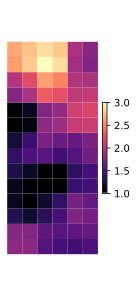

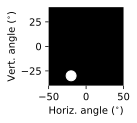

In [19]:
# Figure 3c channel-wide gamma response to RF stimulus
import matplotlib.pyplot as plt
import numpy as np
import pickle
import scipy

# histograms of # of significant channels displayed in Figs. 3d, 4b, 5f
file = '/Volumes/Science/Biology/Paper_data_and_code/Figure 3/' 
#with open(file+'fig3c_rf_data.pkl', 'rb') as h:
#    rf = pickle.load(h)
print(rf.keys())   
cond = rf['condition']
u = np.unique(cond)
cmap = 'magma'

fig,ax=plt.subplots(layout='constrained')
fig.set_size_inches([1.8,4])

ind = np.where(cond==u[14])[0]
me = np.mean(np.max(rf['gamma'][:,:,150:250,ind],axis=2),axis=-1)

zf = 5
fx = range(4)
fy = range(8)

dd = scipy.ndimage.zoom(me, [zf,zf])
fx = scipy.ndimage.zoom(range(4),zf)
fy = scipy.ndimage.zoom(range(8),zf)

vmin=1
vmax=3

pcm = ax.pcolormesh(fx,fy,dd,cmap=cmap,vmin=vmin,vmax=vmax)
ax.axis('equal')
ax.axis('off')
cbar=plt.colorbar(pcm,ax=ax,fraction = 0.05)
plt.show()

fig,ax=plt.subplots(layout='constrained')
fig.set_size_inches([1.8,1.6])

x = rf['xpos'][ind[0]]
y = rf['ypos'][ind[0]]
ax.plot(x,y,'wo',markersize=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

ax.set_xlim([-50,50])
ax.set_ylim([-40,40])
ax.set_facecolor('k')
ax.set_xlabel('Horiz. angle ($^{\circ}$)')
ax.set_ylabel('Vert. angle ($^{\circ}$)')
plt.show()

/Users/eknudsen/miniforge3/envs/ecog_clone/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/eknudsen/miniforge3/envs/ecog_clone/lib/python3.9/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


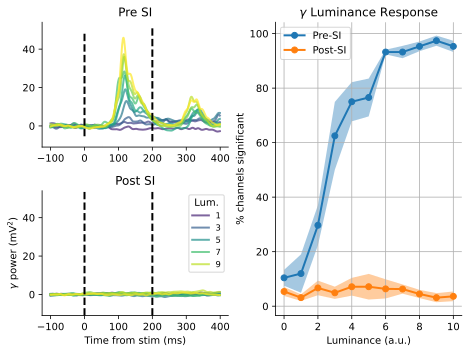

In [17]:
# Figure 3g: pre and post sodium iodate V1 measures:
%matplotlib inline
from IPython.display import set_matplotlib_formats
from matplotlib import cm
import matplotlib.pyplot as plt
import numpy as np
import pickle

# LOAD DATA:
file = '/Volumes/Science/Biology/Paper_data_and_code/Figure 3/fig3g_example_rabbit.pkl'
with open(file, 'rb') as h:
    ex_rbt = pickle.load(h)

fig, ax = plt.subplot_mosaic([['upper left','right'],['lower left','right']],layout='constrained')

viridis = cm.get_cmap('viridis', 11)
col = viridis(range(11))
col[:,-1]=0.7

u1 = np.unique(ex_rbt['session01']['condition']).astype(int)-1
for u in u1:
    ind = np.where(ex_rbt['session01']['condition']==u)[0]
    m = np.mean(np.mean(ex_rbt['session01']['gamma'][:,:,ind],axis=-1),axis=-1)
    t = np.arange(-100,400,1)
    ax['upper left'].plot(t,m,color=col[int(u),:],lw=2)
    
ax['upper left'].set_title('Pre SI')
ax['upper left'].spines['top'].set_visible(False)
ax['upper left'].spines['right'].set_visible(False)
ax['upper left'].plot([0,0],ax['upper left'].get_ylim(),'k--',lw=2)
ax['upper left'].plot([200,200],ax['upper left'].get_ylim(),'k--',lw=2)

u2 = np.unique(ex_rbt['session02']['condition']).astype(int)-1
for u in u2:
    ind = np.where(ex_rbt['session02']['condition']==u)[0]
    m = np.mean(np.mean(ex_rbt['session02']['gamma'][:,:,ind],axis=-1),axis=-1)
    if u%2:
        ax['lower left'].plot(t,m,color=col[int(u),:],lw=2,label=str(u))
    else:
        ax['lower left'].plot(t,m,color=col[int(u),:],lw=2)

ax['lower left'].set_title('Post SI')
ax['lower left'].set_xlabel('Time from stim (ms)')
ax['lower left'].set_ylabel('$\gamma$ power (mV$^{2}$)')
ax['lower left'].legend(loc=1,title='Lum.',fancybox=True,fontsize='small')    
ax['lower left'].plot([0,0],ax['upper left'].get_ylim(),'k--',lw=2)
ax['lower left'].plot([200,200],ax['upper left'].get_ylim(),'k--',lw=2)
ax['lower left'].set_ylim(ax['upper left'].get_ylim())
ax['lower left'].spines['top'].set_visible(False)
ax['lower left'].spines['right'].set_visible(False)

import numpy as np
import matplotlib.pyplot as plt
filename = '/Volumes/Science/Biology/Paper_data_and_code/Figure 3/session01_luminance_all_rabbits.txt'
bhv_data = np.loadtxt(filename,dtype="float",delimiter='\t')
lum = bhv_data[:,2:]

filename = '/Volumes/Science/Biology/Paper_data_and_code/Figure 3/session02_luminance_all_rabbits.txt'
bhv_dataSI = np.loadtxt(filename,dtype="float",delimiter='\t')
lumSI = bhv_dataSI[:,2:]


m = lum.mean(axis=0)
s = lum.std(axis=0)/np.sqrt(lum.shape[0])
t = range(11)
ax['right'].fill_between(t,100*(m-s),100*(m+s),facecolor='tab:blue',edgecolor='none',alpha=0.4)
ax['right'].plot(t,100*m,'o-',color='tab:blue',lw=2,label='Pre-SI')
#ax.plot(lum.transpose(),'.-',lw=2,color='tab:blue')
#ax.plot(lum.mean(axis=0),'ko-')


m = lumSI.mean(axis=0)
s = lumSI.std(axis=0)/np.sqrt(lum.shape[0])
t = range(11)
ax['right'].fill_between(t,100*(m-s),100*(m+s),facecolor='tab:orange',edgecolor='none',alpha=0.4)
ax['right'].plot(t,100*m,'o-',color='tab:orange',lw=2,label='Post-SI')
#ax.plot(lumSI.transpose(),'.-',lw=2,color='tab:orange')
#ax.plot(lumSI.mean(axis=0),'ko-')
ax['right'].set_ylabel('% channels significant')
ax['right'].set_xlabel('Luminance (a.u.)')
ax['right'].legend(loc=0)
ax['right'].spines['top'].set_visible(False)
ax['right'].spines['right'].set_visible(False)
ax['right'].set_title('$\gamma$ Luminance Response')
ax['right'].grid(True)
#sv_dir = '/Users/eknudsen/Documents/paper_figures/Figure 3 - SI V1 responses/'
#plt.savefig(sv_dir+'luminancePrePost_SI.pdf',dpi=300,format='pdf')
#plt.savefig(sv_dir+'luminancePrePost_SI.svg',dpi=300,format='svg')
plt.show()